In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import rasterio
from rasterio.plot import show
from matplotlib.ticker import ScalarFormatter
import geopandas as gpd
from shapely.geometry import Point
import cmocean
from pyproj import Transformer
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1 import make_axes_locatable

C:\Users\15093\anaconda3\envs\gpgn-318\Lib\site-packages\pyproj\network.py:59: UserWarning: pyproj unable to set PROJ database path.
  _set_context_ca_bundle_path(ca_bundle_path)


In [2]:
total_df = pd.read_csv('total_df.csv')
tif_harding = rasterio.open('2good harding cove_modified.tif')
tif_keystone = rasterio.open('Keystonetif.tif')

In [4]:
KEY_Full = total_df[total_df['Area'] == 'KEY']
KEY_Full

KEY_Full['UTC Time'] = pd.to_datetime(KEY_Full['UTC Time'])
KEY_18 = KEY_Full[KEY_Full['UTC Time'].dt.date == pd.to_datetime('2025-05-18').date()]

C:\Users\15093\AppData\Local\Temp\ipykernel_23416\2581798182.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  KEY_Full['UTC Time'] = pd.to_datetime(KEY_Full['UTC Time'])


In [5]:
HAR_Full = total_df[total_df['Area'] == 'HAR']
HAR_Full

HAR_Full['UTC Time'] = pd.to_datetime(HAR_Full['UTC Time'])
HAR_17 = HAR_Full[HAR_Full['UTC Time'].dt.date == pd.to_datetime('2025-05-17').date()]

C:\Users\15093\AppData\Local\Temp\ipykernel_23416\2068102814.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HAR_Full['UTC Time'] = pd.to_datetime(HAR_Full['UTC Time'])


In [33]:
KEYpressure_p15 = KEY_18[KEY_18['Pressure (dbar)'] == 0.15]
HARpressure_p15 = HAR_17[HAR_17['Pressure (dbar)'] == 0.15]
KEYpressure_p45 = KEY_18[KEY_18['Pressure (dbar)'] == 0.45]
HARpressure_p45 = HAR_17[HAR_17['Pressure (dbar)'] == 0.45]
KEYpressure_p75 = KEY_18[np.isclose(KEY_18['Pressure (dbar)'], 0.75)]
HARpressure_p75 = HAR_17[np.isclose(HAR_17['Pressure (dbar)'], 0.75)]
KEYpressure_1p05 = KEY_18[KEY_18['Pressure (dbar)'] == 1.05]
HARpressure_1p05 = HAR_17[HAR_17['Pressure (dbar)'] == 1.05]

# HAR TEMP

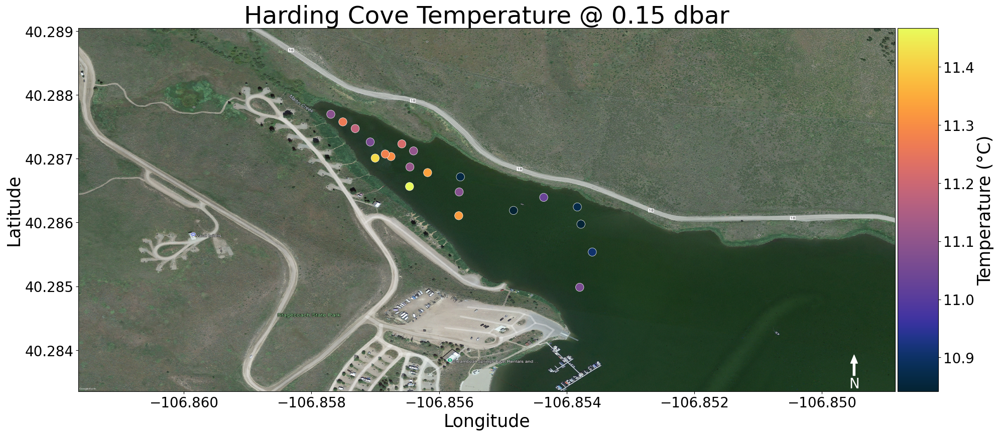

In [13]:
fig, ax = plt.subplots(figsize=(20, 20))

show(tif_harding, ax=ax)

sc = ax.scatter(
    HARpressure_p15['Longitude'],
    HARpressure_p15['Latitude'],
    c=HARpressure_p15['Temperature (°C)'],
    cmap=cmocean.cm.thermal,
    s=140,
    edgecolor='white',
    linewidth=0.5
)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)  # size and pad control bar width and spacing

cbar = fig.colorbar(sc, cax=cax)
cbar.set_label("Temperature (°C)", fontsize=25)
cbar.ax.tick_params(labelsize=20)

ax.set_xlabel("Longitude", fontsize=25)
ax.set_ylabel("Latitude", fontsize=25)

ax.tick_params(axis='both', which='major', labelsize=20)

# north arrow
ax.annotate(
    'N',
    xy=(0.95, 0.10),
    xytext=(0.95, 0.02),
    arrowprops=dict(
        facecolor='white',
        edgecolor='white',
        width=3,
        headwidth=10
    ),
    color='white',
    ha='center',
    va='center',
    fontsize=20,
    xycoords='axes fraction'
)

ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.xaxis.get_major_formatter().set_useOffset(False)
ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.yaxis.get_major_formatter().set_useOffset(False)
ax.set_title('Harding Cove Temperature @ 0.15 dbar', fontsize=35, loc='center')
plt.tight_layout()
plt.show()

# HAR COND

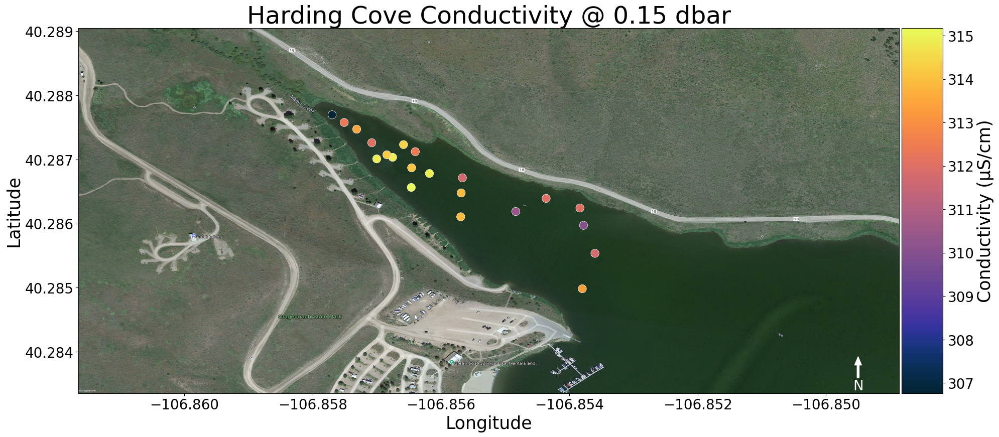

In [9]:
fig, ax = plt.subplots(figsize=(20, 20))

show(tif_harding, ax=ax)

sc = ax.scatter(
    HARpressure_p15['Longitude'],
    HARpressure_p15['Latitude'],
    c=HARpressure_p15['Conductivity (µS/cm)'],
    cmap=cmocean.cm.thermal,
    s=140,
    edgecolor='white',
    linewidth=0.5
)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)  # size and pad control bar width and spacing

cbar = fig.colorbar(sc, cax=cax)
cbar.set_label("Conductivity (µS/cm)", fontsize=25)
cbar.ax.tick_params(labelsize=20)

ax.set_xlabel("Longitude", fontsize=25)
ax.set_ylabel("Latitude", fontsize=25)

ax.tick_params(axis='both', which='major', labelsize=20)

# north arrow
ax.annotate(
    'N',
    xy=(0.95, 0.10),
    xytext=(0.95, 0.02),
    arrowprops=dict(
        facecolor='white',
        edgecolor='white',
        width=3,
        headwidth=10
    ),
    color='white',
    ha='center',
    va='center',
    fontsize=20,
    xycoords='axes fraction'
)

ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.xaxis.get_major_formatter().set_useOffset(False)
ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.yaxis.get_major_formatter().set_useOffset(False)
ax.set_title('Harding Cove Conductivity @ 0.15 dbar', fontsize=35, loc='center')
plt.tight_layout()
plt.show()

# KEY TEMP

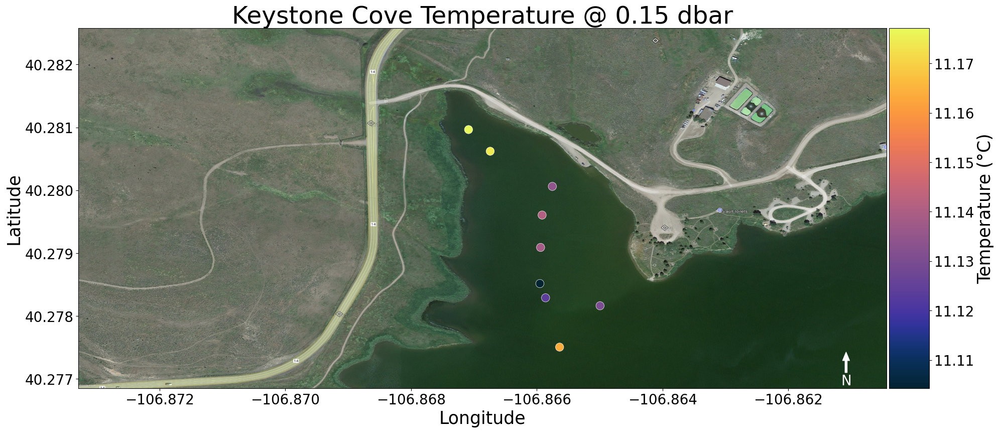

In [14]:
fig, ax = plt.subplots(figsize=(20, 20))

show(tif_keystone, ax=ax)

sc = ax.scatter(
    KEYpressure_p15['Longitude'],
    KEYpressure_p15['Latitude'],
    c=KEYpressure_p15['Temperature (°C)'],
    cmap=cmocean.cm.thermal,
    s=140,
    edgecolor='white',
    linewidth=0.5
)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)  # size and pad control bar width and spacing

cbar = fig.colorbar(sc, cax=cax)
cbar.set_label("Temperature (°C)", fontsize=25)
cbar.ax.tick_params(labelsize=20)

ax.set_xlabel("Longitude", fontsize=25)
ax.set_ylabel("Latitude", fontsize=25)

ax.tick_params(axis='both', which='major', labelsize=20)

# north arrow
ax.annotate(
    'N',
    xy=(0.95, 0.10),
    xytext=(0.95, 0.02),
    arrowprops=dict(
        facecolor='white',
        edgecolor='white',
        width=3,
        headwidth=10
    ),
    color='white',
    ha='center',
    va='center',
    fontsize=20,
    xycoords='axes fraction'
)

ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.xaxis.get_major_formatter().set_useOffset(False)
ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.yaxis.get_major_formatter().set_useOffset(False)
ax.set_title('Keystone Cove Temperature @ 0.15 dbar', fontsize=35, loc='center')
plt.tight_layout()
plt.show()

# KEY COND

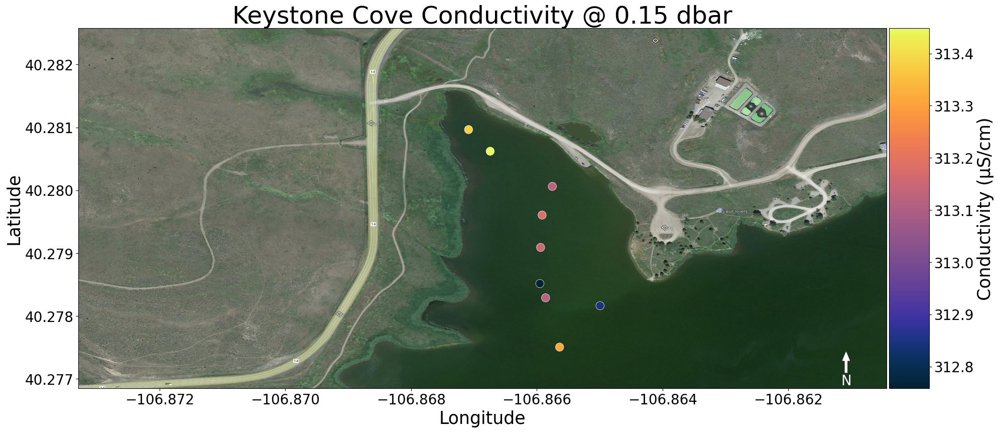

In [12]:
fig, ax = plt.subplots(figsize=(20, 20))

show(tif_keystone, ax=ax)

sc = ax.scatter(
    KEYpressure_p15['Longitude'],
    KEYpressure_p15['Latitude'],
    c=KEYpressure_p15['Conductivity (µS/cm)'],
    cmap=cmocean.cm.thermal,
    s=140,
    edgecolor='white',
    linewidth=0.5
)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)  # size and pad control bar width and spacing

cbar = fig.colorbar(sc, cax=cax)
cbar.set_label("Conductivity (µS/cm)", fontsize=25)
cbar.ax.tick_params(labelsize=20)

ax.set_xlabel("Longitude", fontsize=25)
ax.set_ylabel("Latitude", fontsize=25)

ax.tick_params(axis='both', which='major', labelsize=20)

# north arrow
ax.annotate(
    'N',
    xy=(0.95, 0.10),
    xytext=(0.95, 0.02),
    arrowprops=dict(
        facecolor='white',
        edgecolor='white',
        width=3,
        headwidth=10
    ),
    color='white',
    ha='center',
    va='center',
    fontsize=20,
    xycoords='axes fraction'
)

ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.xaxis.get_major_formatter().set_useOffset(False)
ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
ax.yaxis.get_major_formatter().set_useOffset(False)
ax.set_title('Keystone Cove Conductivity @ 0.15 dbar', fontsize=35, loc='center')
plt.tight_layout()
plt.show()

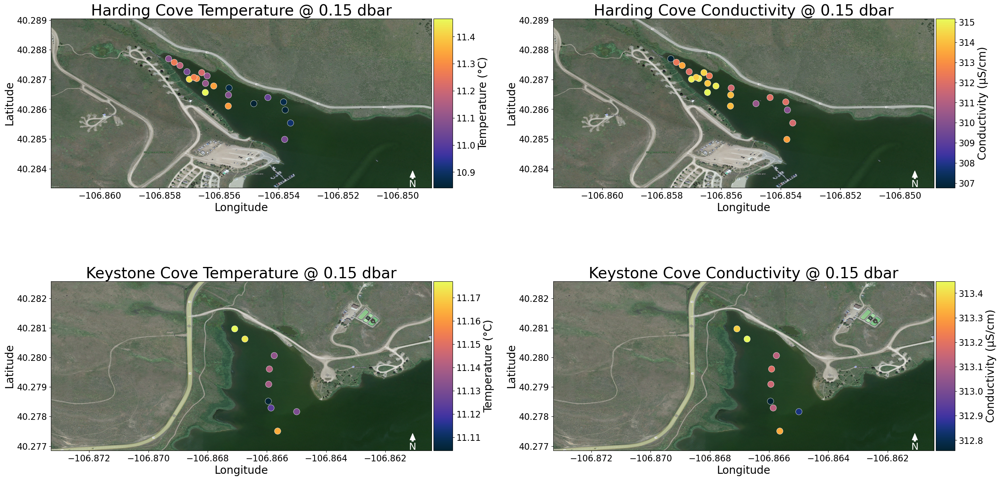

In [26]:
plot_data = [
    ('Harding Cove Temperature @ 0.15 dbar', tif_harding, HARpressure_p15, 'Temperature (°C)', 'thermal'),
    ('Harding Cove Conductivity @ 0.15 dbar', tif_harding, HARpressure_p15, 'Conductivity (µS/cm)', 'thermal'),
    ('Keystone Cove Temperature @ 0.15 dbar', tif_keystone, KEYpressure_p15, 'Temperature (°C)', 'thermal'),
    ('Keystone Cove Conductivity @ 0.15 dbar', tif_keystone, KEYpressure_p15, 'Conductivity (µS/cm)', 'thermal')
]

fig, axs = plt.subplots(2, 2, figsize=(30, 15))

for ax, (title, tif, df, var, cmap) in zip(axs.flat, plot_data):
    show(tif, ax=ax)

    sc = ax.scatter(
        df['Longitude'],
        df['Latitude'],
        c=df[var],
        cmap=getattr(cmocean.cm, cmap),
        s=140,
        edgecolor='white',
        linewidth=0.5
    )

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = fig.colorbar(sc, cax=cax)
    cbar.set_label(var, fontsize=20)
    cbar.ax.tick_params(labelsize=16)

    ax.set_title(title, fontsize=28)
    ax.set_xlabel("Longitude", fontsize=20)
    ax.set_ylabel("Latitude", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=16)

    # North arrow
    ax.annotate(
        'N',
        xy=(0.95, 0.10),
        xytext=(0.95, 0.02),
        arrowprops=dict(
            facecolor='white',
            edgecolor='white',
            width=3,
            headwidth=10
        ),
        color='white',
        ha='center',
        va='center',
        fontsize=18,
        xycoords='axes fraction'
    )

    ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.xaxis.get_major_formatter().set_useOffset(False)
    ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.yaxis.get_major_formatter().set_useOffset(False)

plt.subplots_adjust(hspace=0.005, wspace=0.25, top=0.95, bottom=0.05)
plt.show()

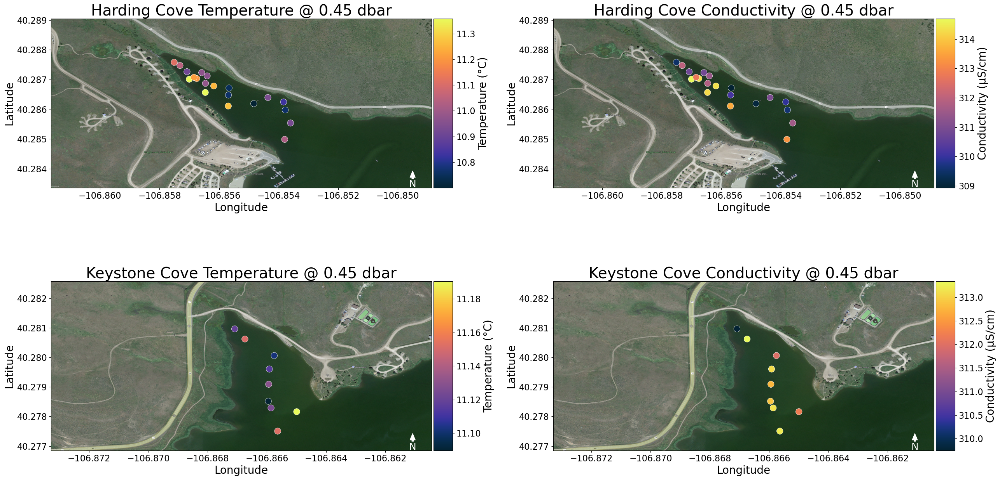

In [28]:
# Define plot parameters
plot_data = [
    ('Harding Cove Temperature @ 0.45 dbar', tif_harding, HARpressure_p45, 'Temperature (°C)', 'thermal'),
    ('Harding Cove Conductivity @ 0.45 dbar', tif_harding, HARpressure_p45, 'Conductivity (µS/cm)', 'thermal'),
    ('Keystone Cove Temperature @ 0.45 dbar', tif_keystone, KEYpressure_p45, 'Temperature (°C)', 'thermal'),
    ('Keystone Cove Conductivity @ 0.45 dbar', tif_keystone, KEYpressure_p45, 'Conductivity (µS/cm)', 'thermal')
]

fig, axs = plt.subplots(2, 2, figsize=(30, 15))

for ax, (title, tif, df, var, cmap) in zip(axs.flat, plot_data):
    show(tif, ax=ax)

    sc = ax.scatter(
        df['Longitude'],
        df['Latitude'],
        c=df[var],
        cmap=getattr(cmocean.cm, cmap),
        s=140,
        edgecolor='white',
        linewidth=0.5
    )

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = fig.colorbar(sc, cax=cax)
    cbar.set_label(var, fontsize=20)
    cbar.ax.tick_params(labelsize=16)

    ax.set_title(title, fontsize=28)
    ax.set_xlabel("Longitude", fontsize=20)
    ax.set_ylabel("Latitude", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=16)

    # North arrow
    ax.annotate(
        'N',
        xy=(0.95, 0.10),
        xytext=(0.95, 0.02),
        arrowprops=dict(
            facecolor='white',
            edgecolor='white',
            width=3,
            headwidth=10
        ),
        color='white',
        ha='center',
        va='center',
        fontsize=18,
        xycoords='axes fraction'
    )

    ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.xaxis.get_major_formatter().set_useOffset(False)
    ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.yaxis.get_major_formatter().set_useOffset(False)

plt.subplots_adjust(hspace=0.005, wspace=0.25, top=0.95, bottom=0.05)
plt.show()

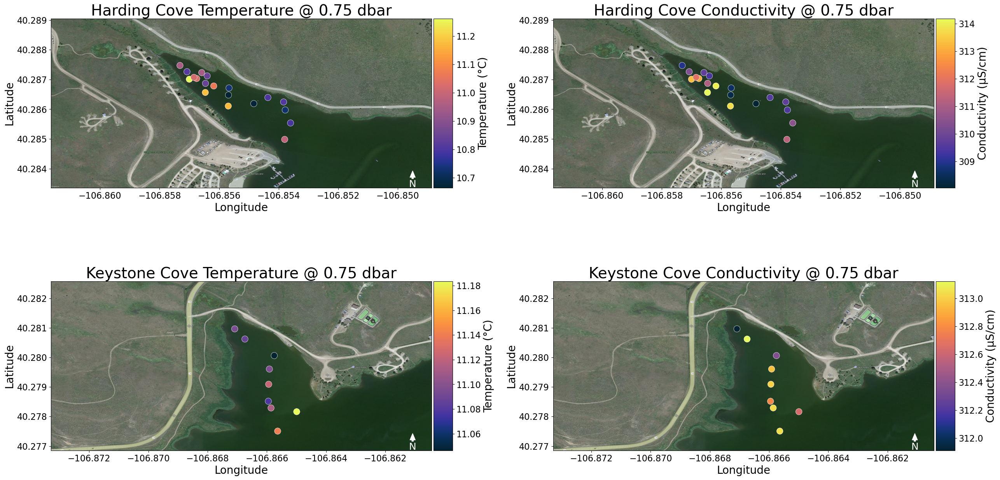

In [34]:
# Define plot parameters
plot_data = [
    ('Harding Cove Temperature @ 0.75 dbar', tif_harding, HARpressure_p75, 'Temperature (°C)', 'thermal'),
    ('Harding Cove Conductivity @ 0.75 dbar', tif_harding, HARpressure_p75, 'Conductivity (µS/cm)', 'thermal'),
    ('Keystone Cove Temperature @ 0.75 dbar', tif_keystone, KEYpressure_p75, 'Temperature (°C)', 'thermal'),
    ('Keystone Cove Conductivity @ 0.75 dbar', tif_keystone, KEYpressure_p75, 'Conductivity (µS/cm)', 'thermal')
]

fig, axs = plt.subplots(2, 2, figsize=(30, 15))

for ax, (title, tif, df, var, cmap) in zip(axs.flat, plot_data):
    show(tif, ax=ax)

    sc = ax.scatter(
        df['Longitude'],
        df['Latitude'],
        c=df[var],
        cmap=getattr(cmocean.cm, cmap),
        s=140,
        edgecolor='white',
        linewidth=0.5
    )

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = fig.colorbar(sc, cax=cax)
    cbar.set_label(var, fontsize=20)
    cbar.ax.tick_params(labelsize=16)

    ax.set_title(title, fontsize=28)
    ax.set_xlabel("Longitude", fontsize=20)
    ax.set_ylabel("Latitude", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=16)

    # North arrow
    ax.annotate(
        'N',
        xy=(0.95, 0.10),
        xytext=(0.95, 0.02),
        arrowprops=dict(
            facecolor='white',
            edgecolor='white',
            width=3,
            headwidth=10
        ),
        color='white',
        ha='center',
        va='center',
        fontsize=18,
        xycoords='axes fraction'
    )

    ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.xaxis.get_major_formatter().set_useOffset(False)
    ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.yaxis.get_major_formatter().set_useOffset(False)

plt.subplots_adjust(hspace=0.005, wspace=0.25, top=0.95, bottom=0.05)
plt.show()

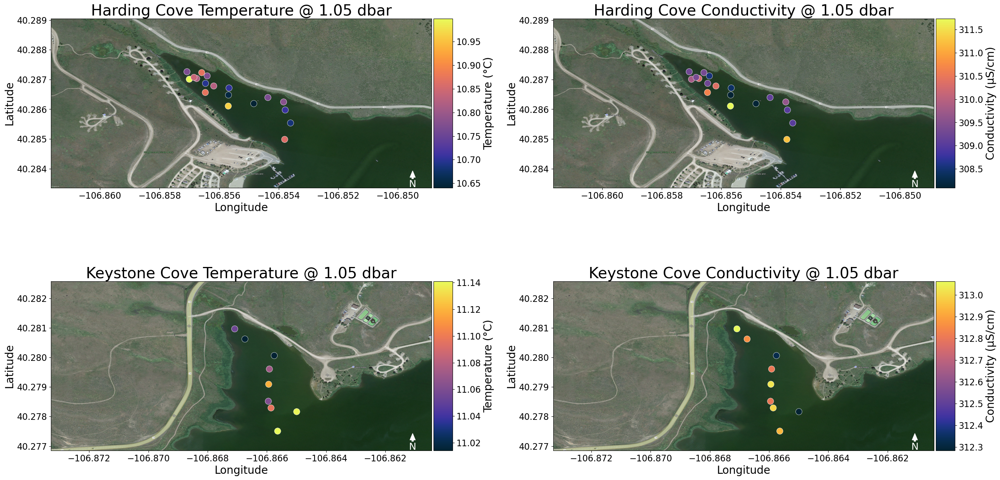

In [30]:
# Define plot parameters
plot_data = [
    ('Harding Cove Temperature @ 1.05 dbar', tif_harding, HARpressure_1p05, 'Temperature (°C)', 'thermal'),
    ('Harding Cove Conductivity @ 1.05 dbar', tif_harding, HARpressure_1p05, 'Conductivity (µS/cm)', 'thermal'),
    ('Keystone Cove Temperature @ 1.05 dbar', tif_keystone, KEYpressure_1p05, 'Temperature (°C)', 'thermal'),
    ('Keystone Cove Conductivity @ 1.05 dbar', tif_keystone, KEYpressure_1p05, 'Conductivity (µS/cm)', 'thermal')
]

fig, axs = plt.subplots(2, 2, figsize=(30, 15))

for ax, (title, tif, df, var, cmap) in zip(axs.flat, plot_data):
    show(tif, ax=ax)

    sc = ax.scatter(
        df['Longitude'],
        df['Latitude'],
        c=df[var],
        cmap=getattr(cmocean.cm, cmap),
        s=140,
        edgecolor='white',
        linewidth=0.5
    )

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    cbar = fig.colorbar(sc, cax=cax)
    cbar.set_label(var, fontsize=20)
    cbar.ax.tick_params(labelsize=16)

    ax.set_title(title, fontsize=28)
    ax.set_xlabel("Longitude", fontsize=20)
    ax.set_ylabel("Latitude", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=16)

    # North arrow
    ax.annotate(
        'N',
        xy=(0.95, 0.10),
        xytext=(0.95, 0.02),
        arrowprops=dict(
            facecolor='white',
            edgecolor='white',
            width=3,
            headwidth=10
        ),
        color='white',
        ha='center',
        va='center',
        fontsize=18,
        xycoords='axes fraction'
    )

    ax.xaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.xaxis.get_major_formatter().set_useOffset(False)
    ax.yaxis.set_major_formatter(mticker.ScalarFormatter(useMathText=False))
    ax.yaxis.get_major_formatter().set_useOffset(False)

plt.subplots_adjust(hspace=0.005, wspace=0.25, top=0.95, bottom=0.05)
plt.show()